# Regular Expressions (Pattern Matching), Worksheet

## Today
* Hw1 is posted and due Th 1/30 at 11:59 pm
* Introduction to me
* Programming for Informatics Applications
* Text pattern matching using regular expressions
* Search and hw1 - thinking like a computer
* Worksheet

## Before Anything Else, Why Wasn't I Here Last Time?

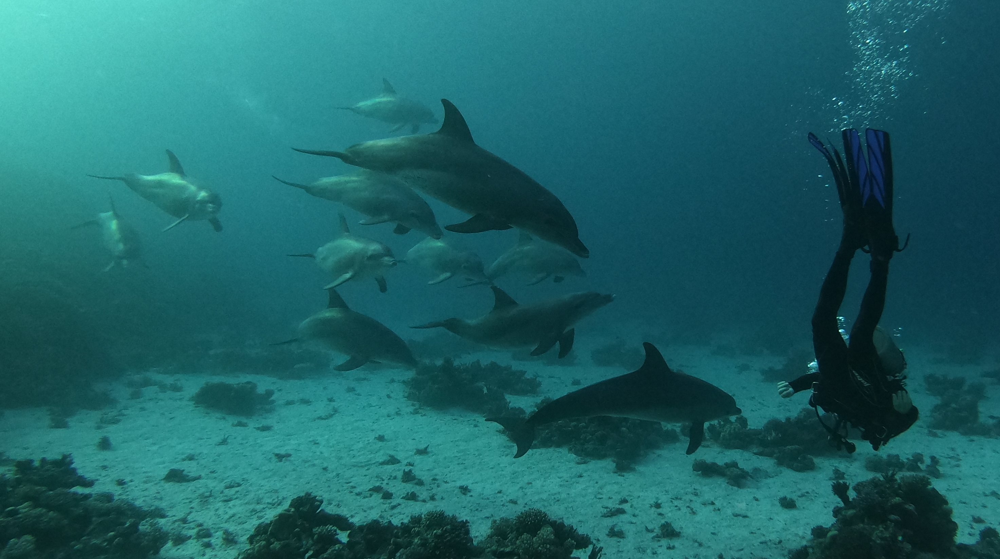

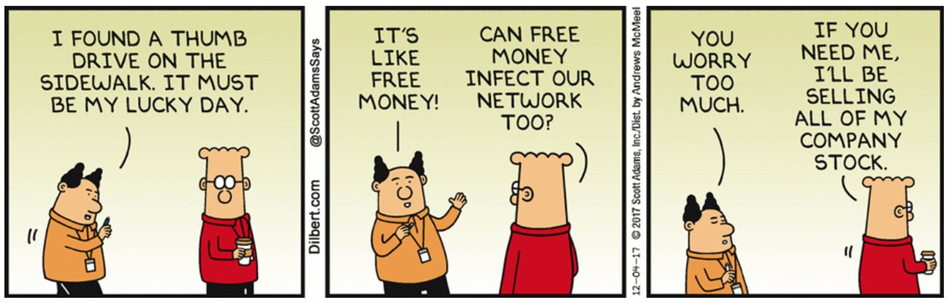

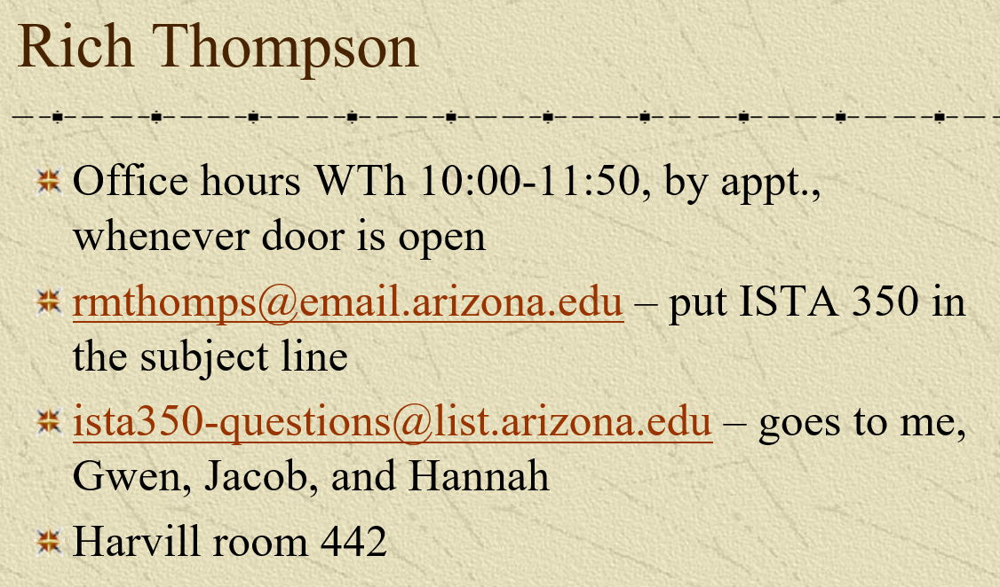

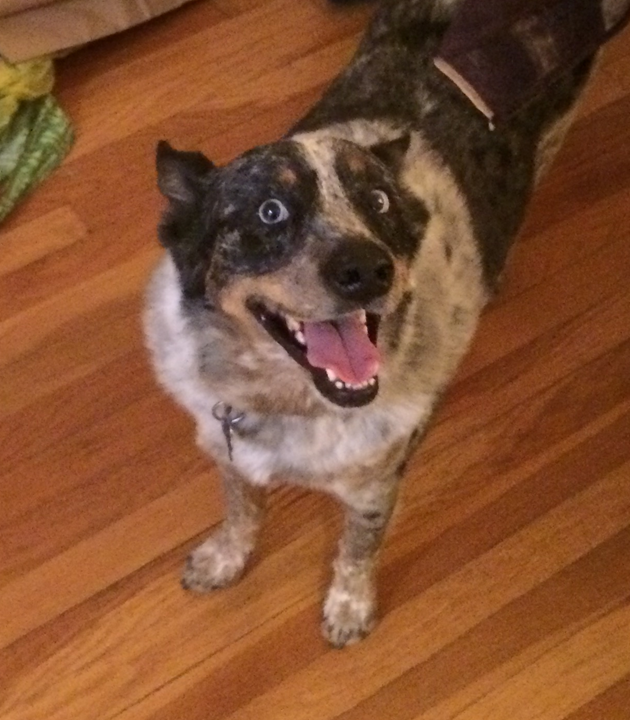

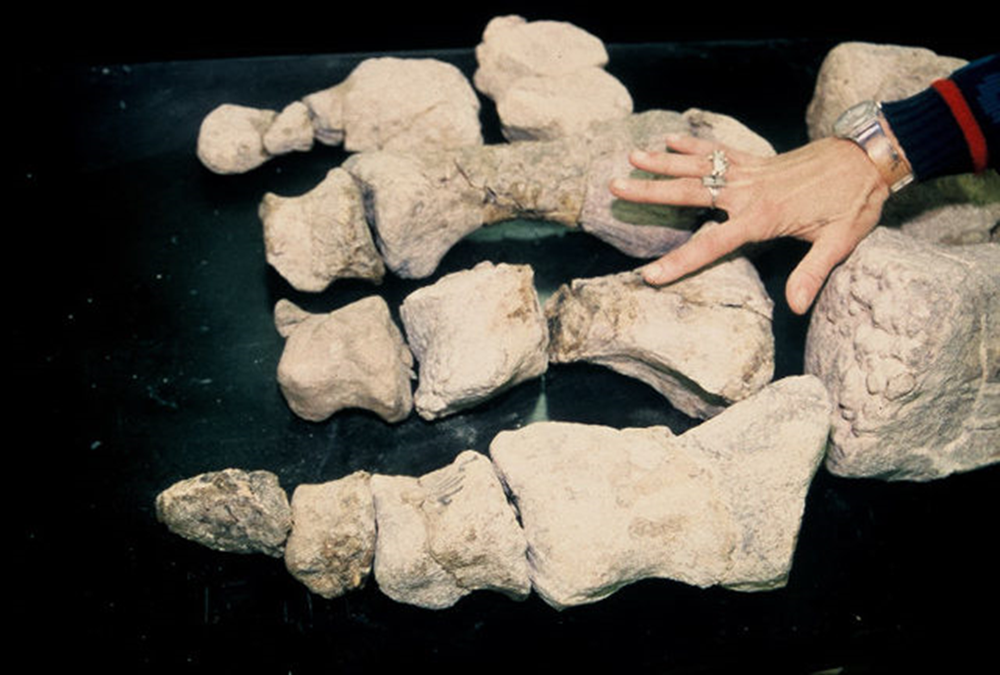

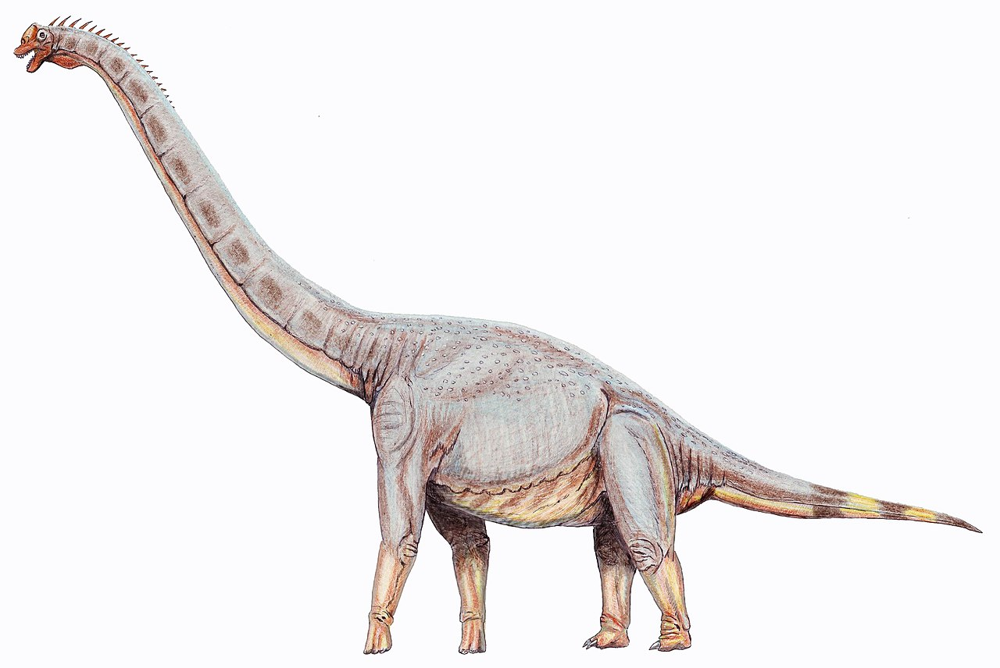

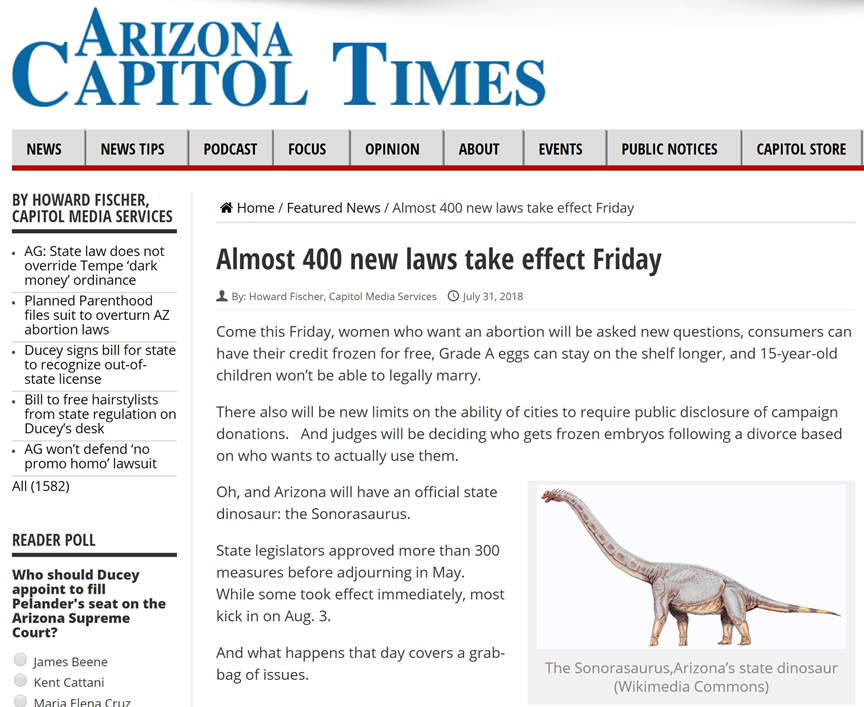

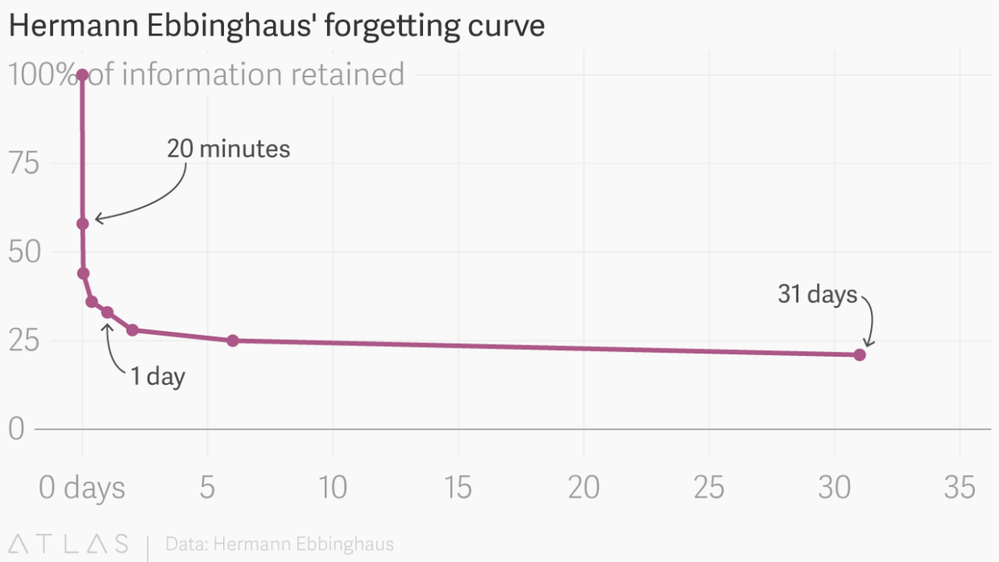

https://www.retrievalpractice.org/
* Why we do worksheets

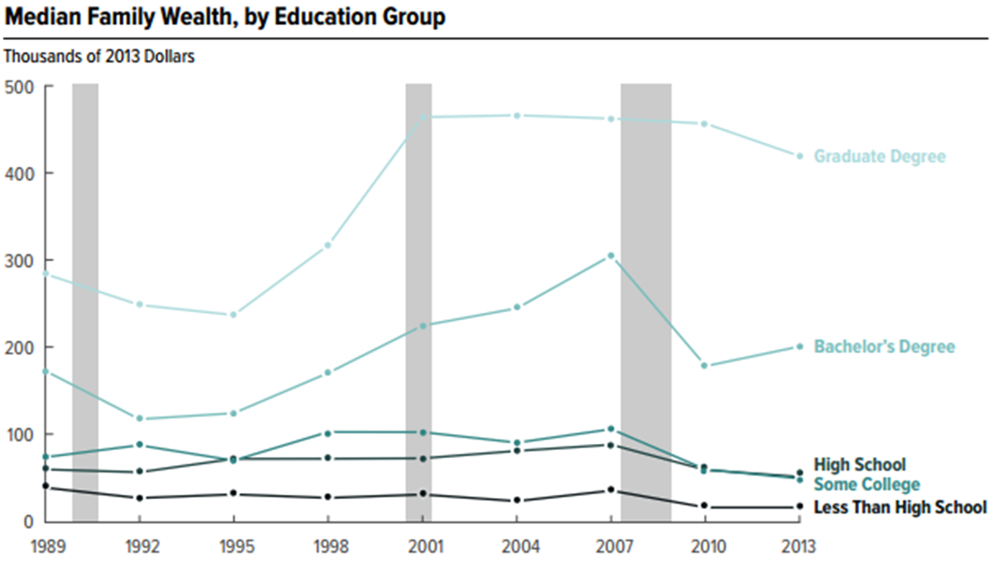

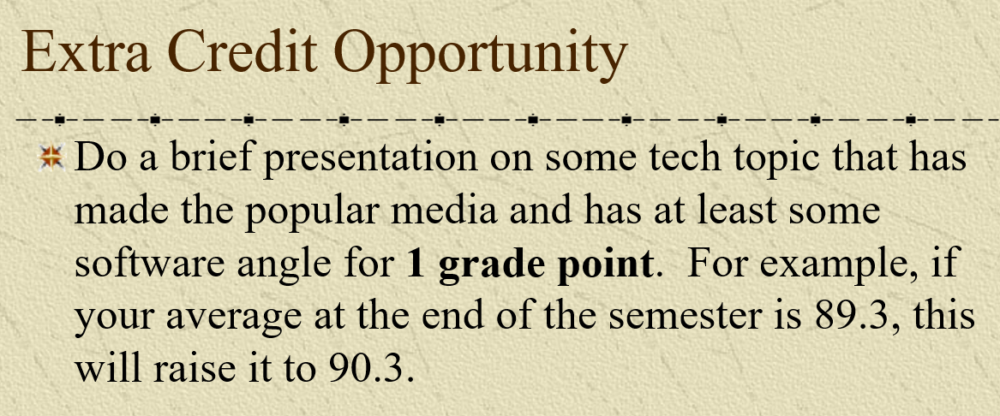

## https://en.wikipedia.org/wiki/Informatics

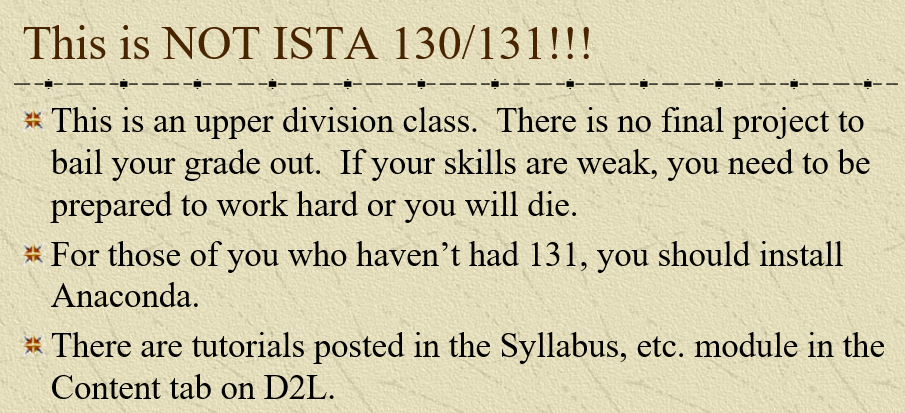

## Goals of the Course
* Increase your programming skills and knowledge of computer science
    - Linked data structures in Python
    - Web scraping
    - Some stats review
* Introduce you to some new tools
* Help you prepare for your life professionally and personally
* https://sites.google.com/site/steveyegge2/five-essential-phone-screen-questions
* https://www.tiobe.com/tiobe-index/

## Last Time
* Review
* Worksheet

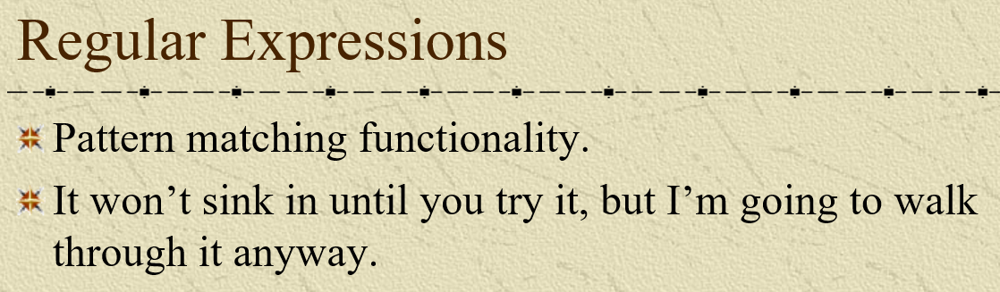

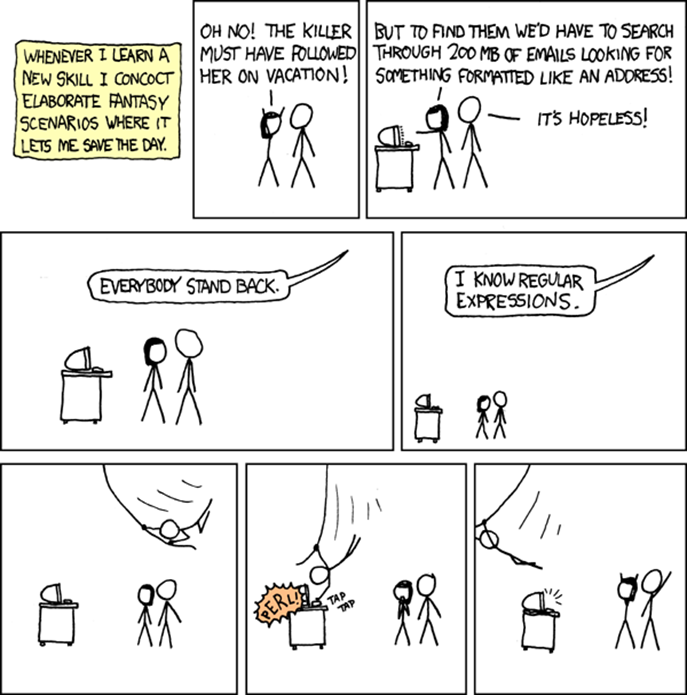

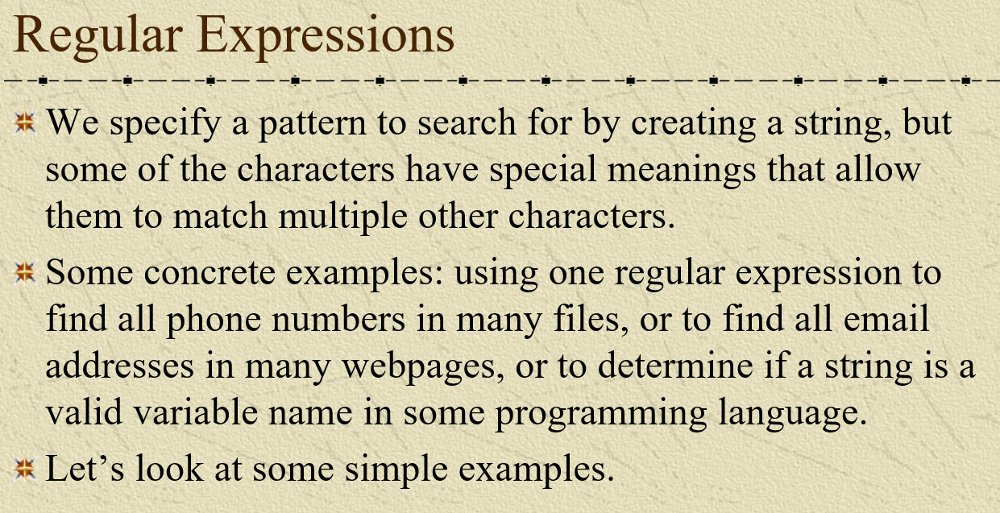

In [1]:
import re

In [2]:
p = re.compile(r'(\(\d{3}\)[ -]?|\d{3}-)\d{3}-\d{4}')

<font color=red>***`p` is for pattern.***

<font color=blue>***Do you see anything wrong with the above expression?  <font color=red>It will match if there are too many digits at the end.***

<font color=sandybrown>***Show `iwalktheline2.txt` in the editor, point out the randomly tossed in phone nums.***

In [3]:
text = open('iwalktheline2.txt').read()

In [4]:
m = p.search(text)

<font color=red>***`m` is for match.***

In [5]:
m.group()

'111-111-1111'

<font color=red>***`search` found the first match, but we want them all.***

In [6]:
p.findall(text)

['111-', '(888)-', '999-', '(123)', '800-', '(123) ']

<font color=red>***Uh-oh.  The parentheses in the pattern define a group and that's what findall goes for if there are any.  Groups allow us to bust out specific parts of a match if we want.  So let's make the whole thing a group by adding parentheses aroung the whole expression.  Which will mean we will have two groups for each match, the whole thing and the prefix:***

In [7]:
p = re.compile(r'((\(\d{3}\)[ -]?|\d{3}-)\d{3}-\d{4})') 
p.findall(text)

[('111-111-1111', '111-'),
 ('(888)-888-8888', '(888)-'),
 ('999-999-9999', '999-'),
 ('(123)456-7890', '(123)'),
 ('800-555-7777', '800-'),
 ('(123) 456-7890', '(123) ')]

<font color=red>***Ok, now we have a list of tuples (immutable sequences - like lists except delimited by parentheses instead of square brackets). Each tuple contains the groups for a single match. The first group is the one we want.***

In [8]:
[m[0] for m in p.findall(text)]

['111-111-1111',
 '(888)-888-8888',
 '999-999-9999',
 '(123)456-7890',
 '800-555-7777',
 '(123) 456-7890']

<font color=red>***If we look back at the file, we see that found a match in `1111-111-1111`.  So we would want to fix this up some more if we were actually doing this.***

<font color=red>***Let's get a list of all of the functions in hw1:***

In [9]:
p = re.compile(r'def ([^(]+)') # don't escape inside a character set
text = open('../../hw/hw1/hw1.py').read()
p.findall(text)

['__init__',
 'insert',
 'sort_bills',
 'linear_search',
 'binary_search',
 'check_bills',
 '__eq__',
 'random_100_bill',
 'main',
 'generate_random_bill',
 'generate_dollar_list',
 'main',
 'main_quiz']

<font color=red>***The way `findall` works worked in our favor this time.***

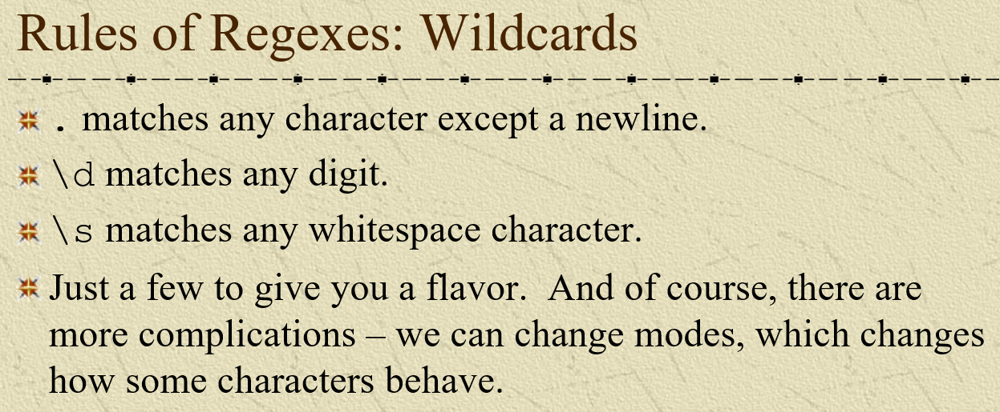

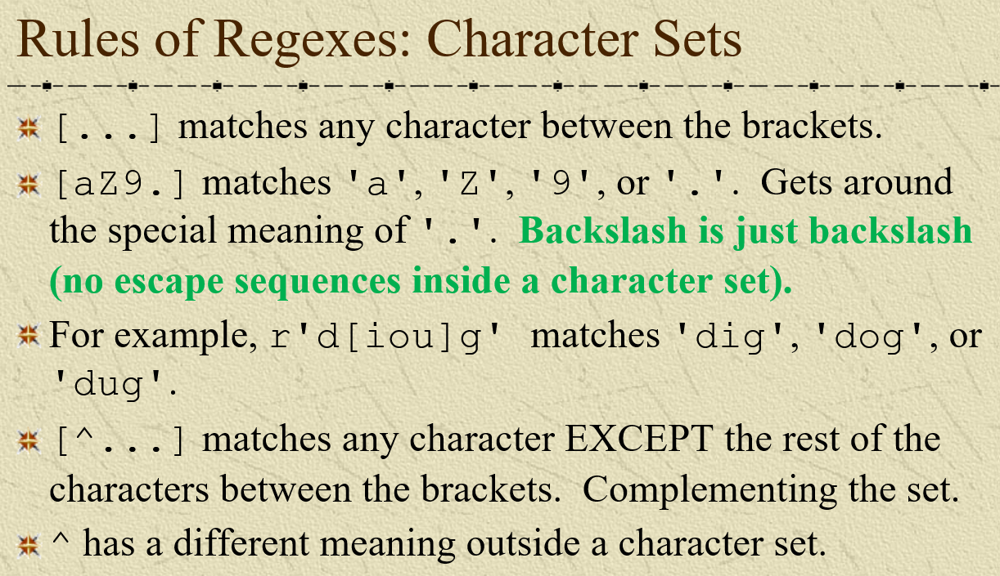

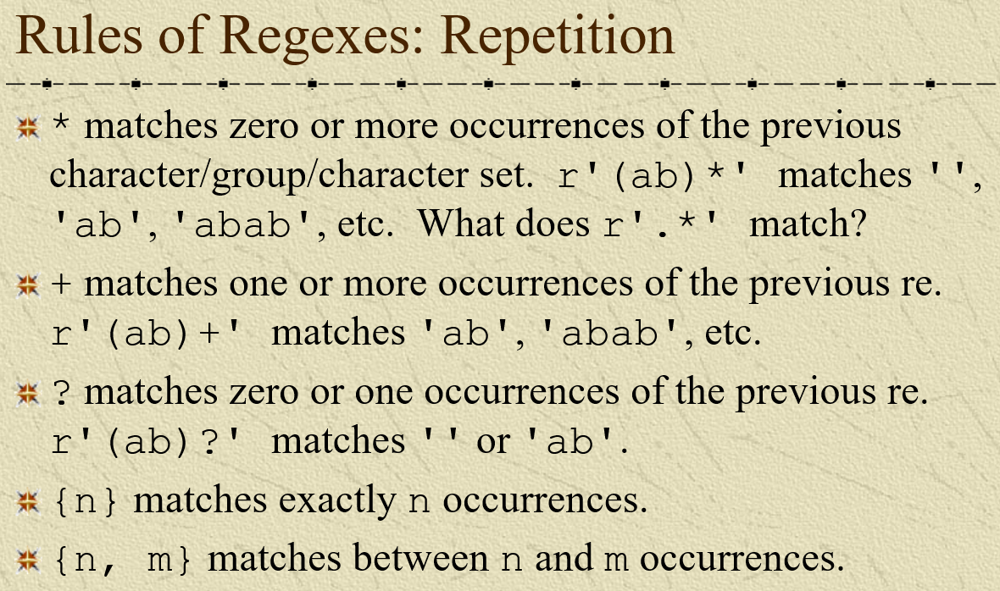

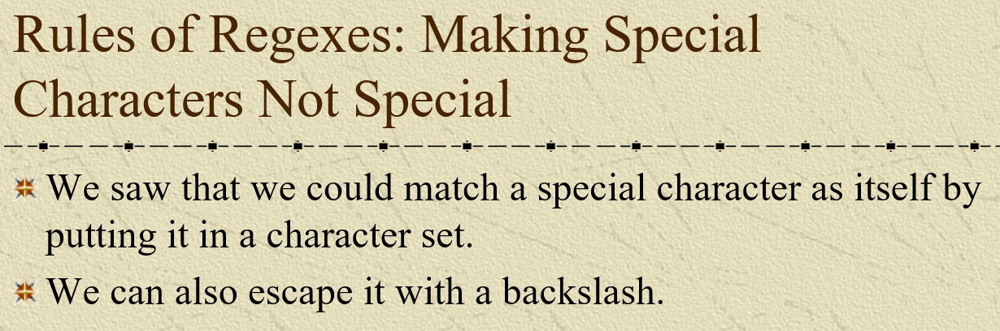

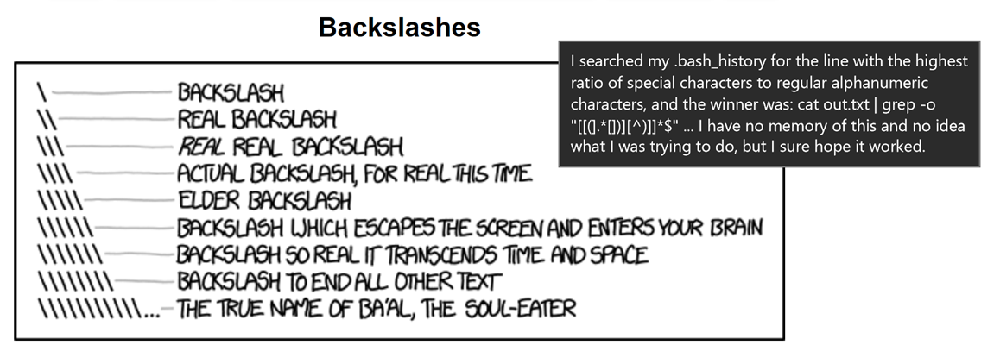

https://www.explainxkcd.com/wiki/index.php/1638:_Backslashes

## Search
* Finding out if a specific item is in a collection is a common programming task.
* We call the item we're searching for the key.  This is not the same as a key in a dictionary.  In computer science, many terms have more than one meaning.

## Linear search
Going through a collection element-by-element looking for the key (from https://www.geeksforgeeks.org/linear-search-vs-binary-search/):

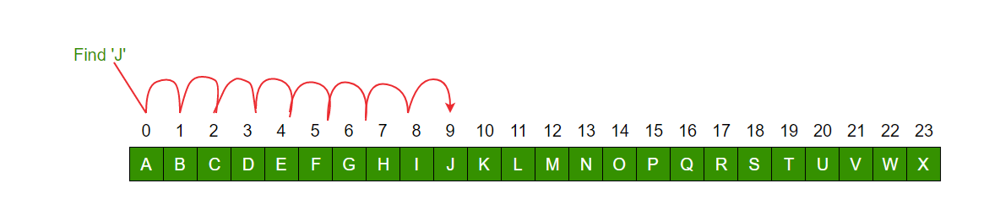

## Binary search
* The collection must be sorted.
* We eliminate half of the remaining items at each step.

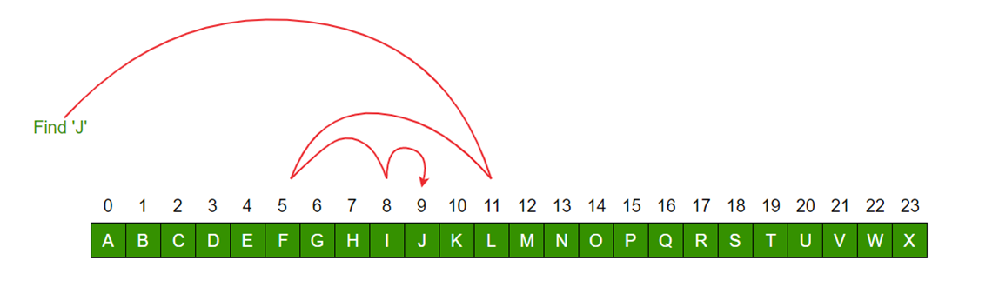

## Linear vs. binary search
* Linear works on any sequence.
* Binary only works on sorted sequences.
* Binary is much faster, but there's a catch...

# Worksheet

Regular expressions are how computer people do pattern matching.  Python has the `re` module for regular expressions.  Here is a little summary of regex highlights:
* Use raw strings for your regexes, e.g. `r"\d+"`, to avoid backslash problems
* Use this syntax to store a regular expression for repeated use: `p = re.compile(<re>)`
* `p.match(str)` matches the beginning of the string
* `p.search(str)` finds the leftmost match
* `p.findall(str)` returns a list of all matching substrings

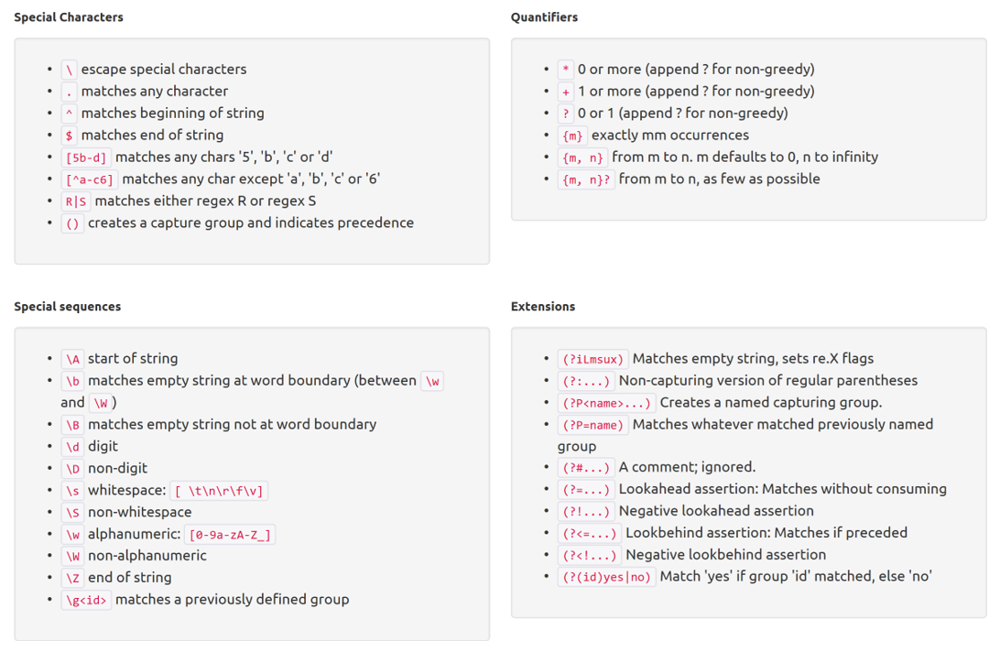

The following code will get a list of all of the filenames in the working directory:

`import os`<br>
`fnames = os.listdir()`

Write a function called `get_scripts` that takes one string argument representing a file extension with a default value of `"py"` and returns a list of all of the files of that type in the working directory.  

In [10]:
import re, os, unittest

In [11]:
def get_scripts(extension='py', path='.'):
    fnames = os.listdir(path)
    # handle cases like .pyc with eos character
    p = re.compile(r'^.*\.' + extension + '$') 
    files = []
    for fname in fnames:
        if p.match(fname):
            files.append(fname)
    return files

get_scripts()

['re_script.py', 'worksheet_regex.py']

In [12]:
get_scripts('pptx')

['01_0827.pptx', '02_0829.pptx']

Write a function called `get_domains` that takes a filename and returns all of the domain names in the file.  The file object `read` method will return the entire contents of the file as a single string.  For our purposes, the definition of a domain name is a sequence of one or more labels separated by dots followed by a dot and 2 or 3 letters (the top-level domain).  Each label has the format: at least one letter followed by zero or more letters/digits/hyphens.  If there is more than one character, the last character must a letter/digit.  Before writing the function, mess with your regex and try to get it to pass the following unit test.  At some point, give up and write function.

In [15]:
class TestFns(unittest.TestCase):
    def test_get_domains_re(self):
        part1 = r'(\A|(?<=[\s:]))([a-zA-Z]([0-9a-zA-Z-]*\w)*\.)+'
        part2 = r'[a-zA-Z]{2,3}(\Z|(?=[\s,])|(?=\.$)|(?=\.\s))'
        p = re.compile(part1 + part2)

        text = 'first1-1one.com I' # for domain string
        self.assertEqual('first1-1one.com', p.search(text).group())
        text = 'some text first-one.com some more text' # for domain string
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.com some more text' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.com' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = ':first-one.com' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.comm.com' 
        self.assertEqual('first-one.comm.com', p.search(text).group())
        text = 'first-one.com' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.com,' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.com.' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'first-one.com ' 
        self.assertEqual('first-one.com', p.search(text).group())
        text = 'some text 1first-one.com some more text' # for domain string
        self.assertIsNone(p.search(text))
        text = 'some text first-one.com.x some more text' # for domain string
        self.assertIsNone(p.search(text))
        text = 'some text first-one.com., some more text' # for domain string
        self.assertIsNone(p.search(text))
        text = 'some text first-one.c some more text' # for domain string
        self.assertIsNone(p.search(text)) # Nonetype object has no attribute group
        text = 'line,one-at-the-end.hey' # for domain string
        self.assertIsNone(p.search(text)) # Nonetype object has no attribute group
        text = 'some text first-one-.c some more text' # for domain string
        self.assertIsNone(p.search(text)) # Nonetype object has no attribute group
        text = 'some text $first-one.com some more text' # for domain string
        self.assertIsNone(p.search(text)) 
        text = 'some text first-one.us some more text' # for domain string
        self.assertEqual('first-one.us', p.search(text).group())
        # break it by ending label with -:
        text = 'some text first-.com some more text' # for domain string
        self.assertIsNone(p.search(text)) # Nonetype object has no attribute group
        # try two hyphens two ways:
        text = 'some text first--one.com some more text' # for domain string
        self.assertEqual('first--one.com', p.search(text).group())
        text = 'some text first-one-two.com some more text' # for domain string
        self.assertEqual('first-one-two.com', p.search(text).group())
        # try two labels (a subdomain):
        text = 'some text first-one.second-two.com some more text' # for domain string
        self.assertEqual('first-one.second-two.com', p.search(text).group())
        text = 'some text third.bad.comm some more text' # for domain string
        self.assertIsNone(p.search(text)) 
        text = 'watch second.bad.comm on' # for domain string
        self.assertIsNone(p.search(text)) 

test = unittest.defaultTestLoader.loadTestsFromTestCase(TestFns)
unittest.TextTestRunner().run(test)

.
----------------------------------------------------------------------
Ran 1 test in 0.001s

OK


<unittest.runner.TextTestResult run=1 errors=0 failures=0>

In [14]:
def get_domains(fname):
    text = open(fname).read()
    # add the top-level group for findall:
    p = re.compile(r'((\A|(?<=[\s:]))([a-zA-Z]([0-9a-zA-Z-]*\w)*\.)+[a-zA-Z]{2,3}(\Z|(?=[\s,])|(?=\.$)|(?=\.\s)))')
    return [group[0] for group in p.findall(text)]
    
get_domains('iwalktheline2.txt')

['first1-1one.com', 'third.hey-ok.wtf']